# import packages

In [1]:
import numpy as np
import pandas as pd
import os
import geopandas as gpd
import matplotlib.pyplot as plt

In [2]:
%matplotlib inline

# import data

In [3]:
root_dir = os.getcwd() + "/mappingExamples/"
#root_dir =  "/mappingExmaples/"
path_pittBoundary = root_dir + 'City_Boundary.shp'
path_pittRoads = root_dir + "Pittsburgh_Roads.shp"
path_alleRoads = root_dir + "Allegheny_Roads.shp"
path_pittBuildings = root_dir + "Pittsburgh_Buildings.shp"
path_pittPOIs = root_dir + "Pittsburgh_POIs.shp"
# = root_dir + ""

In [4]:
pittBoundary = gpd.read_file(path_pittBoundary)
pittRoads = gpd.read_file(path_pittRoads)
alleRoads = gpd.read_file(path_alleRoads)
pittBuildings = gpd.read_file(path_pittBuildings)
pitt_POIs = gpd.read_file(path_pittPOIs)

# Data Processing

Set up colors and line width for different classes of roads, for code reference please see: http://download.geofabrik.de/osm-data-in-gis-formats-free.pdf

In [5]:
pittRoads['lineColor'] = None
# major road white
pittRoads.loc[pittRoads['code']<5114,['lineColor']]= '#ffffff'
pittRoads.loc[(pittRoads['code']<5120)&(pittRoads['code']>5113),['lineColor']]= '#bbbbbb'
pittRoads.loc[(pittRoads['code']<5130)&(pittRoads['code']>5120),['lineColor']]= '#888888'
pittRoads.loc[(pittRoads['code']<5140)&(pittRoads['code']>5130),['lineColor']]= '#666666'
pittRoads.loc[(pittRoads['code']<5150)&(pittRoads['code']>5140),['lineColor']]= '#666666'
pittRoads.loc[(pittRoads['code']>5150),['lineColor']]= '#555555'

pittRoads['lineWidth'] = None
# major road white
pittRoads.loc[pittRoads['code']<5114,['lineWidth']]= 5
pittRoads.loc[(pittRoads['code']<5120)&(pittRoads['code']>5113),['lineWidth']]= 4
pittRoads.loc[(pittRoads['code']<5130)&(pittRoads['code']>5120),['lineWidth']]= 3
pittRoads.loc[(pittRoads['code']<5140)&(pittRoads['code']>5130),['lineWidth']]= 2
pittRoads.loc[(pittRoads['code']<5150)&(pittRoads['code']>5140),['lineWidth']]= 1
pittRoads.loc[(pittRoads['code']>5150),['lineWidth']]= 1

Sort road data by the category code so that the major roads can be plotted on top of minor ones

In [6]:
pittRoads = pittRoads.sort_values(by = ['code'], ascending = False)

Adjust the city boundary shapefile's coordinate reference system to aline with the road file

In [7]:
pittBoundary = pittBoundary.to_crs('epsg:4326') # WGS84

# The real thing, mapping

# Example 1, a road map of Pittsburgh 

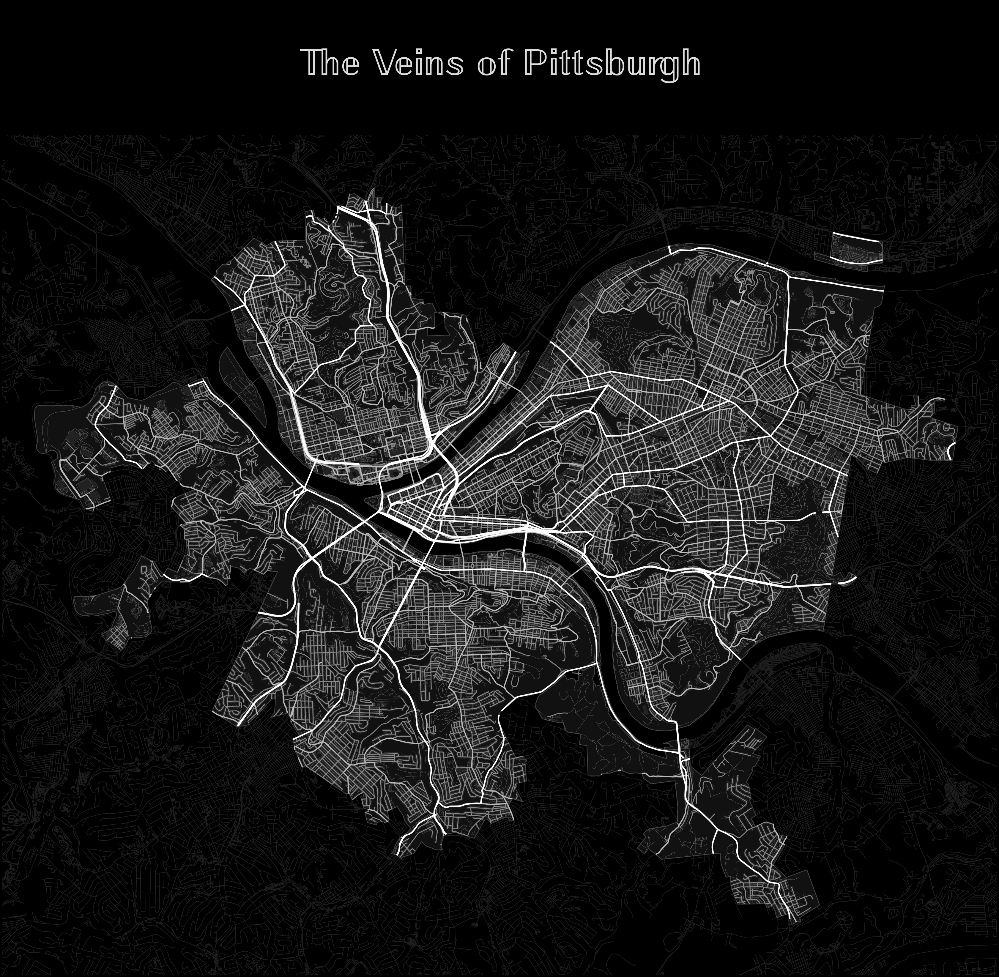

<Figure size 3600x2400 with 0 Axes>

In [8]:
# set up the plot size and background color of the map
fig, ax = plt.subplots(figsize = (60,60))
fig.patch.set_facecolor('#000000')

# turn off the axis so longitude and latitude won't be displayed as x and y axis on the map
ax.axis('off')

# set up the display x, y range
minx, miny, maxx, maxy = pittRoads.total_bounds
ax.set_xlim(minx-.01, maxx+.01)
ax.set_ylim(miny-.01, maxy+.01)

# set up the title
plt.title("\n" + r"$\mathrm{\mathbb{The \ Veins \ of \ Pittsburgh}}$", size = 130, color = '#DDDDDD', y = 1.07) 

# set up figure resolution
plt.figure(dpi = 600)

# draw layers
# The Pittsburgh road layer, of course, is the top layer
pittRoads.plot(ax = ax,
               edgecolor = pittRoads['lineColor'],
               linewidth = pittRoads['lineWidth'],
               zorder = 4)

# To enrich the background, we draw the county's road network in a mysterious deep gray on the bottom layer
alleRoads.plot(ax = ax, 
               color = '#202020',
               linewidth = 2,
               zorder = 1)

# And then we draw the boundary of the city in a not too eyeball-catching color just to indicate the edge
pittBoundary.plot(ax = ax,
                  edgecolor = '#444444',
                  linewidth = 2.5,
                  color = '#111111')

# Use the building layer to give the map more interesting details 
pittBuildings.plot(ax = ax,
                   color = '#222222',
                   edgecolor = '#303030',
                   zorder = 2)

plt.show()

# What could go wrong?

## 1. The coordinate reference system

Let's reload the boundary file with its default CRS

In [12]:
pittBoundary = gpd.read_file(path_pittBoundary)

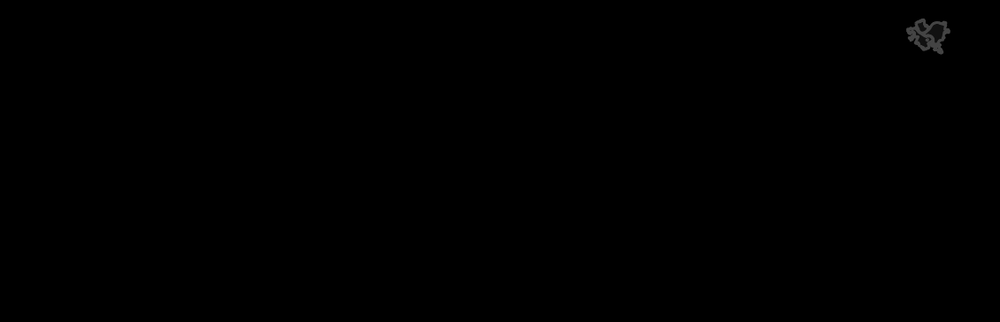

In [13]:
fig, ax = plt.subplots(figsize = (20,20))
fig.patch.set_facecolor('#000000')

ax.axis('off')

# draw layers
pittRoads.plot(ax = ax,
               edgecolor = pittRoads['lineColor'],
               linewidth = pittRoads['lineWidth'],
               zorder = 4)

pittBoundary.plot(ax = ax,
                  edgecolor = '#444444',
                  linewidth = 3,
                  color = '#111111')

plt.show()

The two layers are not aligned, and hence the map couldn't be displayed properly.

## 2. The layers' drawing order

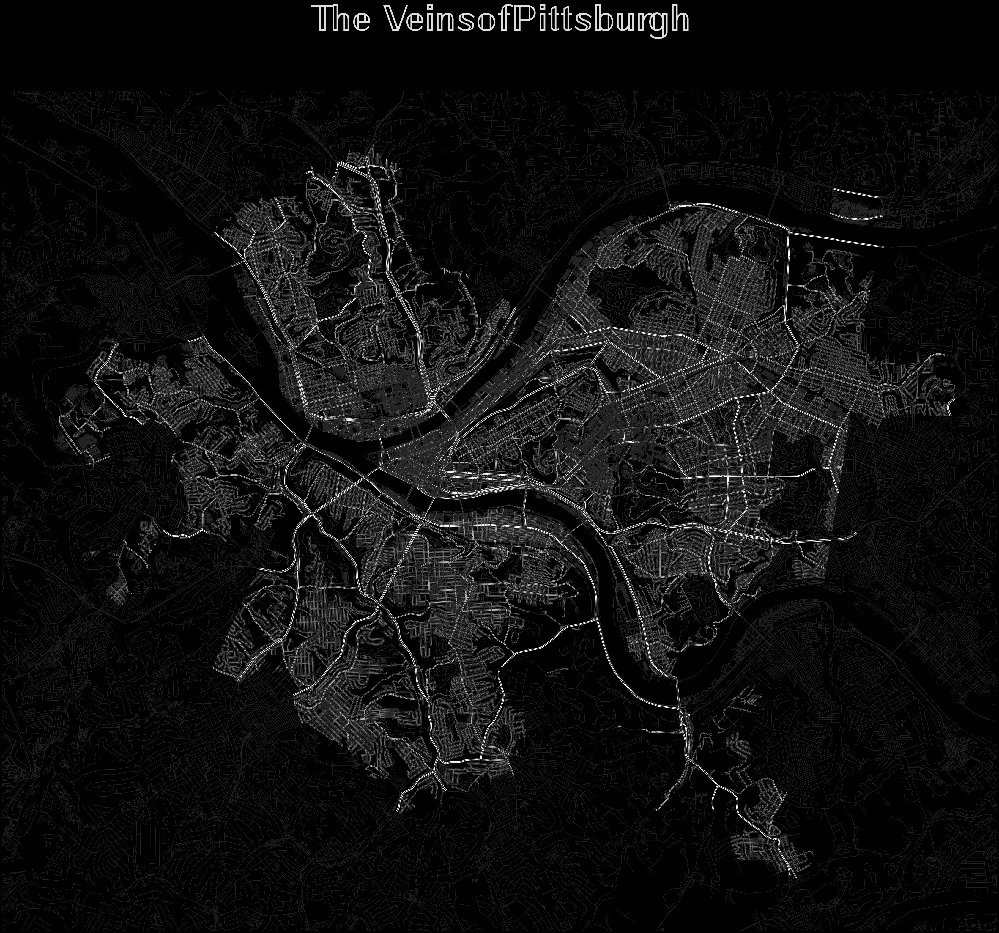

In [15]:
# set up the plot size and background color of the map
fig, ax = plt.subplots(figsize = (60,60))
fig.patch.set_facecolor('#000000')

# turn off the axis so longitude and latitude won't be displayed as x and y axis on the map
ax.axis('off')

# set up the display x, y range
minx, miny, maxx, maxy = pittRoads.total_bounds
ax.set_xlim(minx-.01, maxx+.01)
ax.set_ylim(miny-.01, maxy+.01)

# set up the title
#plt.rcParams['font.family'] = 'DejaVu Sans Mono'# if use iOS system: 'American Typewriter' would look pretty cool on this map
plt.title(r"$\mathrm{\mathbb{The \ Veins \ of \ Pittsburgh}}$", size = 130, color = '#DDDDDD', y = 1.07) 

# draw layers, here we mute the "zorder"
pittRoads.plot(ax = ax,
               edgecolor = pittRoads['lineColor'],
               linewidth = pittRoads['lineWidth'],
               # zorder = 4
               )
alleRoads.plot(ax = ax, 
              color = '#222222',
              # zorder = 1
              )
pittBoundary.plot(ax = ax,
                  edgecolor = '#444444',
                  linewidth = 3,
                  color = '#111111')

pittBuildings.plot(ax = ax,
                   color = '#222222',
                   edgecolor = '#303030',
                   # zorder = 2
                   )

plt.show()

The layers will be organized in the order of your code paragraphs, layers in the newly written lines will be stacked on top.

# Example 2, a catering map of Pittsburgh downtown

set up a different set of color for roads in this map

In [9]:
pittRoads['lineColor2'] = None
# major road white
pittRoads.loc[pittRoads['code']<5114,['lineColor2']]= '#a07f68'
pittRoads.loc[(pittRoads['code']<5120)&(pittRoads['code']>5113),['lineColor2']]= '#b18a70'
pittRoads.loc[(pittRoads['code']<5130)&(pittRoads['code']>5120),['lineColor2']]= '#c29978'
pittRoads.loc[(pittRoads['code']<5140)&(pittRoads['code']>5130),['lineColor2']]= '#cca885'
pittRoads.loc[(pittRoads['code']<5150)&(pittRoads['code']>5140),['lineColor2']]= '#cca885'#'#d8ba9e'
pittRoads.loc[(pittRoads['code']>5150),['lineColor2']]= '#cca885'#'#d8ba9e'

filter out caterings from the POIs geodataset

In [10]:
pittCaterings = pitt_POIs[(pitt_POIs['code']>2300)&(pitt_POIs['code']<2400)]

In [11]:
pittCaterings.loc[pittCaterings['fclass'] == 'fast_food',['fclass']] = 'fast food'

In [12]:
pittBoundary = gpd.read_file(path_pittBoundary)
pittRoads = pittRoads.to_crs(pittBoundary.crs)
pittCaterings = pittCaterings.to_crs(pittBoundary.crs)
pittBuildings = pittBuildings.to_crs(pittBoundary.crs)

In [13]:
Cclasses = ['fast food', 'cafe', 'restaurant', 'bar', 'pub']
Ccolor = {'fast food':'#e27900', 'cafe':'#592301', 'restaurant':'#a5002d', 'bar':'#082032', 'pub':'#93dd74'}
markers = {'fast food':"$\u2666$", 'cafe':"$\u2663$", 'restaurant':"$\u2665$", 'bar':"$\u2660$", 'pub':"$\u273d$" }

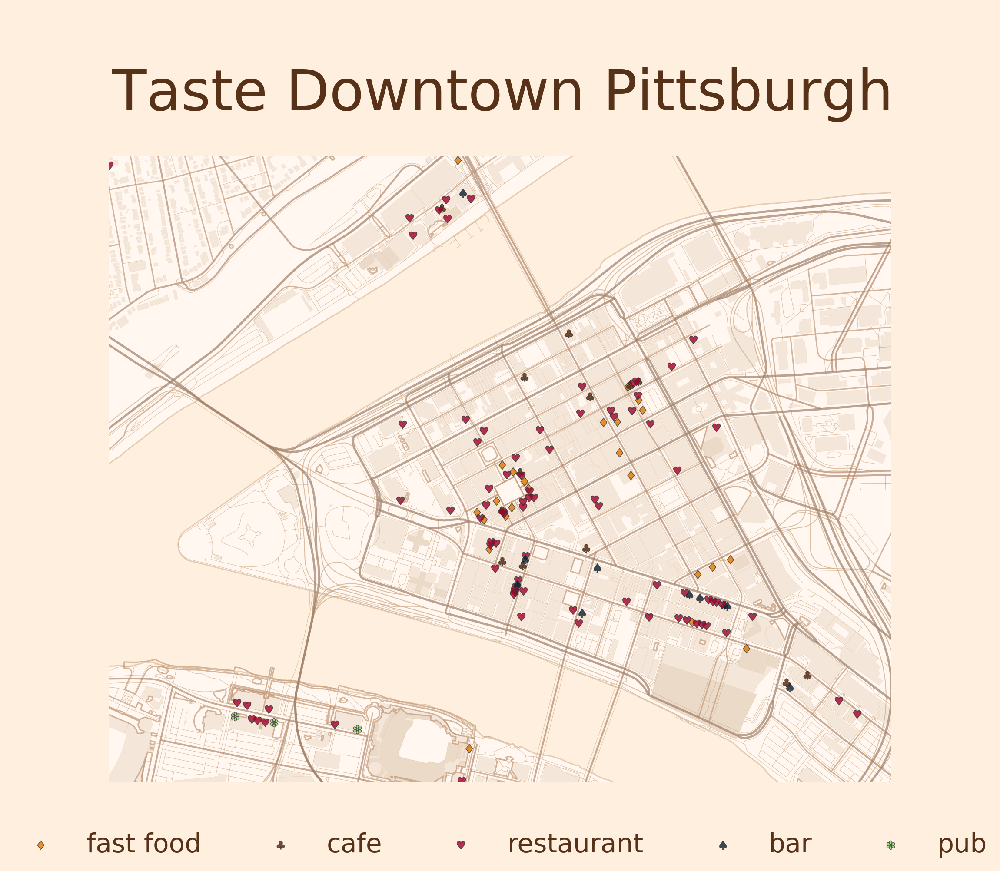

In [49]:
fig, ax = plt.subplots(figsize = (40,40))
fig.patch.set_facecolor('#ffefdf')
ax.axis('off')
minx, miny, maxx, maxy = pittRoads.total_bounds
plt.title("Taste Downtown Pittsburgh", size = 130, color = '#583218', y = 1.07, )
#plt.figure(dpi = 1200)

# plot points 
for Cclass in Cclasses:
    pittCaterings[pittCaterings['fclass'] == Cclass].plot(ax = ax,
                                                          zorder = 5,
                                                          edgecolor = '#333333',
                                                          linewidth = 1.5,
                                                          alpha = .8,
                                                          marker = markers[Cclass], 
                                                          markersize = 400, 
                                                          label = Cclass,
                                                          color = Ccolor[Cclass])
pittRoads.plot(ax = ax,
               edgecolor = pittRoads['lineColor2'],
               linewidth = pittRoads['lineWidth'],
               alpha = .7,
               zorder = 4)

pittBuildings.plot(ax = ax,
                   color = '#cca885',
                   edgecolor = '#ddb892',
                   alpha = .2,
                   zorder = 3)
pittBoundary.plot(ax = ax,
                  zorder = 2,
                  color = '#fff7f0',
                  edgecolor = '#e6ccb2',
                  linewidth = 3)

ax.set_xlim(1338000,1345000)
ax.set_ylim(414000, 408400)
leg = plt.legend(bbox_to_anchor = (.5,-.1),
           loc = 'center', 
           fontsize = 60, 
           ncol = 5, 
           facecolor = '#ffefdf',
           edgecolor = '#ffefdf')
for text in leg.get_texts():
    text.set_color('#583218')
#ax.margins(300)
plt.subplots_adjust(top = .7,bottom = .2)
plt.show() 